<a href="https://colab.research.google.com/github/NJain121442/course2020/blob/master/17August_SEM_Conv2d_V1_M0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install kornia
from kornia import filters
import torch.nn as nn
import glob
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn.functional as F
import torch.optim as optim
from IPython.display import clear_output
from torchvision import datasets, transforms
import numpy as np
from torchsummary import summary 
import matplotlib.image as mpimg
import torchvision
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from PIL import Image

     |████████████████████████████████| 204kB 9.3MB/s 


In [ ]:
#from google.colab import drive 
#drive.mount("/content/drive")

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [1]:
!unzip "/content/M0_120_class_images.zip" -d "/content/"

Archive:  /content/M0_120_class_images.zip
   creating: /content/M0_Selected_class_images/
  inflating: /content/M0_Selected_class_images/Defect_103973_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_105326_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_105665_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_107357_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_107695_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_109387_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111079_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111418_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111756_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_113786_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_11421

In [ ]:
#!unzip '/content/drive/My Drive/AutoEncoder_training.zip' -d '/content/drive/My Drive/AutoEncoder_training' 

In [16]:
#Data_path = "/content/Fruits/"
#Data_path = "/content/drive/My Drive/AutoEncoder_training/AutoEncoder_training/"
#Data_path = "/content/drive/My Drive/All_class_images"
Data_path = "/content/M0_Selected_class_images"

Lets Resize all images to same size

In [37]:
class CustomDataset(Dataset):
  def __init__(self,path,new_size = 226):
    #self.filelist = glob.glob(path+'/*.jfif')
    self.filelist = glob.glob(path+'/*.tiff')
    self.new_size = new_size

  def __len__(self):
    return len(self.filelist)

  def __getitem__(self, idx):
    temp_filepath = self.filelist[idx]
    temp_image = cv2.imread(temp_filepath)
    #print(temp_image)
    #print('Original Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    temp_image = cv2.cvtColor(temp_image, cv2.COLOR_BGR2GRAY)
    #print('Original Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    #dim = (504,504)
    #temp_image = cv2.resize(temp_image, dim, interpolation = cv2.INTER_AREA)
    #print('Resized Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    #print(temp_image.shape)
    temp_image = temp_image/255
    #plt.imshow(temp_image,cmap='gray',vmin=0,vmax=1)
    #temp_image = torch.from_numpy(temp_image)
    temp_image = torch.Tensor(temp_image)
    #print(temp_image.shape)
    #print(temp_image)
    temp_image = temp_image.unsqueeze(0)
    #print(temp_image.shape)
    return temp_image

In [38]:
Data = CustomDataset(Data_path)
Data[2].shape

torch.Size([1, 504, 504])

In [53]:
latent_dim = 128

class Encoder(nn.Module):
    def __init__(self):
        super(Encoder,self).__init__()
        self.enc1 = nn.Conv2d(1,64,kernel_size=3,stride=3)
        self.enc2 = nn.Conv2d(64,128,kernel_size=3,stride=3)
        self.enc3 = nn.Conv2d(128,256,kernel_size=2,stride=3)
        self.pool = nn.MaxPool2d(2,2,return_indices=True)
        self.FC1 = nn.Linear(6400,2048)
        self.FC2 = nn.Linear(2048,512)
        self.FC3 = nn.Linear(512,latent_dim)

    def forward(self,x):
        conv1 = F.relu(self.enc1(x)) # output will be 168x168x64
        x,indices1 = self.pool(conv1) #output will be 84x84x64
        conv2 = F.relu(self.enc2(x)) #output will be 28x28x128
        x,indices2 = self.pool(conv2)   # output will be 14x14x128
        conv3 = F.relu(self.enc3(x)) #output will be 5x5x256 
        x = conv3.view(-1,6400) # after flattening the size will be 6400
        x = F.relu(self.FC1(x))
        x = F.relu(self.FC2(x))
        x = F.relu(self.FC3(x)) # the latent space representation
        return x,indices1,indices2,conv3,conv2,conv1
    
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder,self).__init__()
        self.FC4 = nn.Linear(latent_dim,512)
        self.FC5 = nn.Linear(512,2048)
        self.FC6 = nn.Linear(2048,6400)
        self.dec1 = nn.ConvTranspose2d(256,128, kernel_size=2, stride=3)  
        self.dec2 = nn.ConvTranspose2d(128,64, kernel_size=3, stride=3)
        self.dec3 = nn.ConvTranspose2d(64 ,1, kernel_size=3, stride=3)
        self.unpool = nn.MaxUnpool2d(2,2,padding=0)
        
        
    def forward(self,x,indices1,indices2,conv3,conv2,conv1):
        x = F.relu(self.FC4(x))
        x = F.relu(self.FC5(x))  #size back to 2048
        x = F.relu(self.FC6(x)) #size back to 6400
        x = torch.reshape(x,(1,256,5,5))
        x = F.relu(self.dec1(x)) # ouput will be 14x14x128
        x = self.unpool(x,indices2) #output will be 28x28x128
        x = F.relu(self.dec2(x)) # output will be 84x84x64
        x = self.unpool(x,indices1) #output will be 168x168x64
        #x = self.dec3(x) # output will be 504x504x1
        x = torch.sigmoid(self.dec3(x)) # output will be 504x504x1
        return x
    
class Conv2d_AutoEncoder(nn.Module):
    def __init__(self):
        super(Conv2d_AutoEncoder, self).__init__()

        self.enc = Encoder()
        self.dec = Decoder()

    def forward(self, x):
        
        z,indices1,indices2,conv3,conv2,conv1 = self.enc(x)
        
        out = self.dec(z,indices1,indices2,conv3,conv2,conv1)
        
        return out

**Lets write the first Auto encoder **

In [54]:
net = Conv2d_AutoEncoder()
print(net)
if torch.cuda.is_available():
    net.cuda()
#summary(net,input_size=(1,504,504))

Conv2d_AutoEncoder(
  (enc): Encoder(
    (enc1): Conv2d(1, 64, kernel_size=(3, 3), stride=(3, 3))
    (enc2): Conv2d(64, 128, kernel_size=(3, 3), stride=(3, 3))
    (enc3): Conv2d(128, 256, kernel_size=(2, 2), stride=(3, 3))
    (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (FC1): Linear(in_features=6400, out_features=2048, bias=True)
    (FC2): Linear(in_features=2048, out_features=512, bias=True)
    (FC3): Linear(in_features=512, out_features=128, bias=True)
  )
  (dec): Decoder(
    (FC4): Linear(in_features=128, out_features=512, bias=True)
    (FC5): Linear(in_features=512, out_features=2048, bias=True)
    (FC6): Linear(in_features=2048, out_features=6400, bias=True)
    (dec1): ConvTranspose2d(256, 128, kernel_size=(2, 2), stride=(3, 3))
    (dec2): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(3, 3))
    (dec3): ConvTranspose2d(64, 1, kernel_size=(3, 3), stride=(3, 3))
    (unpool): MaxUnpool2d(kernel_size=(2, 2), stride=(2, 2),

In [55]:
train_loader = DataLoader(Data,batch_size=1)

In [56]:
loss_func = nn.MSELoss()
#loss_func = nn.L1Loss()
optimizer = optim.Adam(net.parameters(), lr=0.0001) 


Training the Auto encoder

In [57]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

n_epochs = 200

if torch.cuda.is_available():
    net.cuda()
total_loss = []

epoch_loss = 0
net.train()
for epoch in tqdm(range(n_epochs)):
    print("current epoch is:",epoch)
    epoch_loss = 0
    for x in train_loader:
        mse_loss = 0
        if torch.cuda.is_available():
          x = x.cuda()
        optimizer.zero_grad()
        prediction = net(x)
        SpatialGradient = filters.SpatialGradient()
        loss_der = loss_func(SpatialGradient(prediction), SpatialGradient(x))
        mse_loss = loss_func(prediction, x) # <-- note that i'm using the input as the target
        epoch_loss = epoch_loss + mse_loss.item() + loss_der.item()
        (mse_loss+loss_der).backward()
        optimizer.step()
        
    #clear_output(wait=True)
    total_loss.append(epoch_loss)
    print('Loss Per epoch: ',epoch_loss)

current epoch is: 0
Loss Per epoch:  7.4949227684992366
current epoch is: 1
Loss Per epoch:  7.0589618685189635
current epoch is: 2
Loss Per epoch:  6.851477991556749
current epoch is: 3
Loss Per epoch:  6.708358782576397
current epoch is: 4
Loss Per epoch:  6.60954649298219
current epoch is: 5
Loss Per epoch:  6.53220853919629
current epoch is: 6
Loss Per epoch:  6.464819515240379
current epoch is: 7
Loss Per epoch:  6.402133763476741
current epoch is: 8
Loss Per epoch:  6.337289789400529
current epoch is: 9
Loss Per epoch:  6.222737229079939
current epoch is: 10
Loss Per epoch:  6.15084116673097
current epoch is: 11
Loss Per epoch:  6.061340995365754
current epoch is: 12
Loss Per epoch:  6.012248907703906
current epoch is: 13
Loss Per epoch:  5.963063653558493
current epoch is: 14
Loss Per epoch:  5.906191025860608
current epoch is: 15
Loss Per epoch:  5.854109990061261
current epoch is: 16
Loss Per epoch:  5.796484890859574
current epoch is: 17
Loss Per epoch:  5.7420532731339335
cu

In [ ]:
import matplotlib.pyplot as plt
plt.plot(total_loss)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


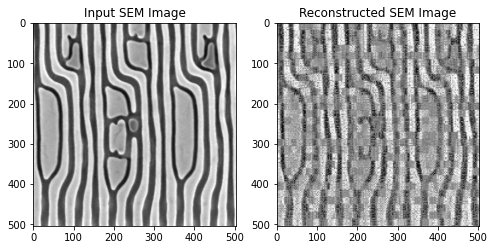

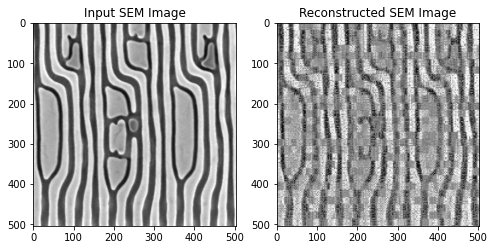

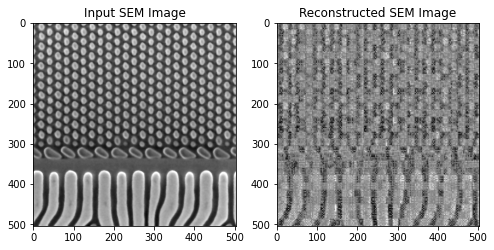

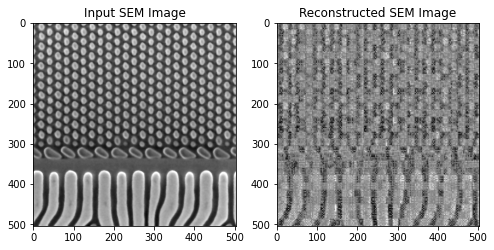

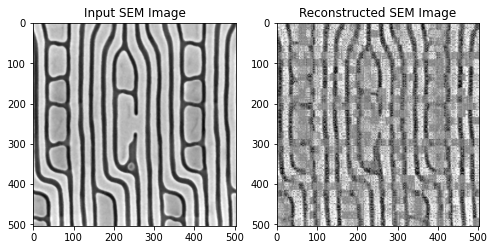

...

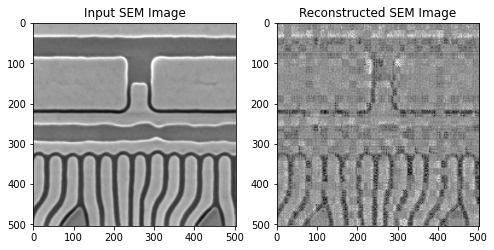

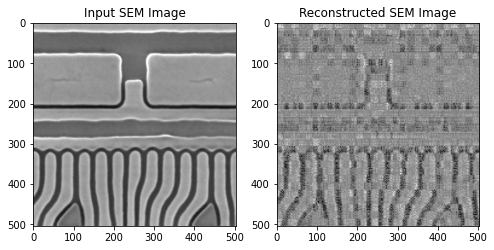

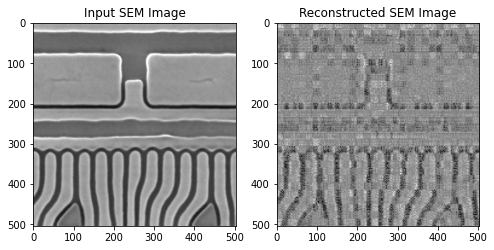

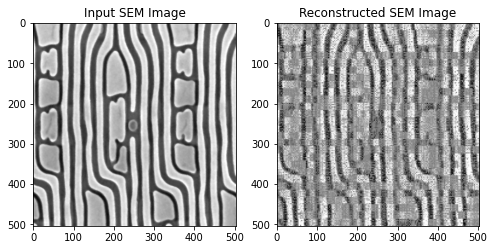

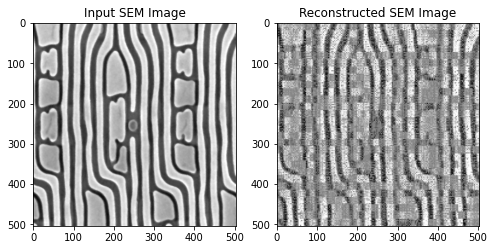

In [59]:
net.cpu()
net.eval()
counter = 0
for i in range(30):
    counter = counter + 1
    fig,ax = plt.subplots(1,2,figsize=(8,4))
    x = Data[i]
    input_img = x[0]
    #print(input_img)
    model_pred = net(x.unsqueeze(0))[0].cpu().data.numpy()[0]
    #print(model_pred)
    ax[0].set_title('Input SEM Image',fontsize=12)
    ax[1].set_title('Reconstructed SEM Image',fontsize=12)
    ax[0].imshow(input_img,cmap='gray',vmin=0,vmax=1)
    ax[1].imshow(model_pred,cmap='gray',vmin=0,vmax=1)


Extract Latent representation from Encoder 

Do Clustering and calculate Silhouette Score

In [60]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn import preprocessing
Encoder_net = Encoder()
Attributes = np.empty([len(train_loader),latent_dim])
#print(Attributes.shape)
for i,x in enumerate(Data):
  Temp_results = Encoder_net(x.unsqueeze(0))
  #print(Temp_results[0])
  Temp_Attributes = (Temp_results[0]).cpu().data.numpy()
  #print("Temp_Attributes:",Temp_Attributes)
  Attributes[i] = Temp_Attributes
  #print(Attributes[i].shape)
#print(Attributes.shape)

In [71]:
from sklearn.feature_selection import VarianceThreshold
k=7
Attributes_scaled = preprocessing.scale(Attributes)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
selector = VarianceThreshold()
Attributes_scaled = selector.fit_transform(Attributes_scaled)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
kmeans = KMeans(n_clusters=k,random_state=0).fit(Attributes_scaled)
Clustering_labels = kmeans.labels_
print(Clustering_labels)
Score = silhouette_score(Attributes_scaled,Clustering_labels,metric='euclidean')
print(Score)
sample_score = silhouette_samples(Attributes_scaled,Clustering_labels,metric='euclidean')
#print(sample_score)

(120, 128)
[1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0.
 0. 1. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0.
 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0.
 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1.
 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 1. 1.
 0. 0. 1. 0. 0. 1. 1. 1.]
(120, 72)
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[1 4 5 3 1 6 5 6 6 0 0 3 2 1 2 2 0 3 4 6 0 1 6 2 0 6 2 2 2 6 4 2 6 4 0 0 0
 2 6 5 2 2 5 2 0 4 0 2 6 4 2 0 5 6 0 2 0 6 5 2 3 1 4 2 2 2 0 0 2 0 4 2 3 4
 2 3 0 1 0 2 6 4 2 4 6 2 5 6 2 4 2 3 0 0 2 4 6 2 2 4 2 3 4 2 2 4 2 4 2 0 3
 1 2 0 0 3 0 4 3 0]
0.1438713972630355


In [72]:
max(sample_score)

0.49700627493002064

Find Optimal K using Silhouette score

In [73]:
import pandas as pd 
column_names = ["Image","Label","Score"]
df = pd.DataFrame(columns = column_names,index=np.arange(len(Data)))
df['Image'][88]

for i,x in enumerate(Data):
  df['Image'][i] = (x[0]).data.numpy()
  df['Label'][i] = Clustering_labels[i]
  df['Score'][i] = sample_score[i]
  #print(input_img)
  df

In [74]:
df= df.sort_values('Label',ignore_index=True)
print(df)
df['Image'][110]

                                                 Image Label      Score
0    [[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.9176470...     0    0.26081
1    [[0.8627451, 0.88235295, 0.91764706, 0.9607843...     0   0.278106
2    [[0.8352941, 0.84705883, 0.85882354, 0.8784314...     0   0.253772
3    [[0.34509805, 0.3882353, 0.5647059, 0.827451, ...     0     0.2868
4    [[0.39215687, 0.42352942, 0.6156863, 0.9568627...     0   0.289895
..                                                 ...   ...        ...
115  [[0.25882354, 0.20392157, 0.14901961, 0.125490...     6  0.0574767
116  [[0.8156863, 0.7490196, 0.60784316, 0.41960785...     6  0.0418631
117  [[0.41568628, 0.34509805, 0.2784314, 0.2392156...     6  0.0118844
118  [[0.1254902, 0.14901961, 0.20392157, 0.3058823...     6   0.121722
119  [[0.12941177, 0.15294118, 0.21960784, 0.349019...     6   0.237212

[120 rows x 3 columns]


array([[0.21960784, 0.2901961 , 0.5529412 , ..., 0.9019608 , 0.9372549 ,
        0.9529412 ],
       [0.21568628, 0.28235295, 0.49019608, ..., 0.90588236, 0.9372549 ,
        0.9529412 ],
       [0.21176471, 0.27450982, 0.47843137, ..., 0.90588236, 0.9372549 ,
        0.95686275],
       ...,
       [0.22352941, 0.22745098, 0.23921569, ..., 0.6431373 , 0.61960787,
        0.59607846],
       [0.19607843, 0.19607843, 0.2       , ..., 0.64705884, 0.627451  ,
        0.60784316],
       [0.18431373, 0.18431373, 0.1882353 , ..., 0.6509804 , 0.63529414,
        0.6117647 ]], dtype=float32)

120


<function matplotlib.pyplot.show>

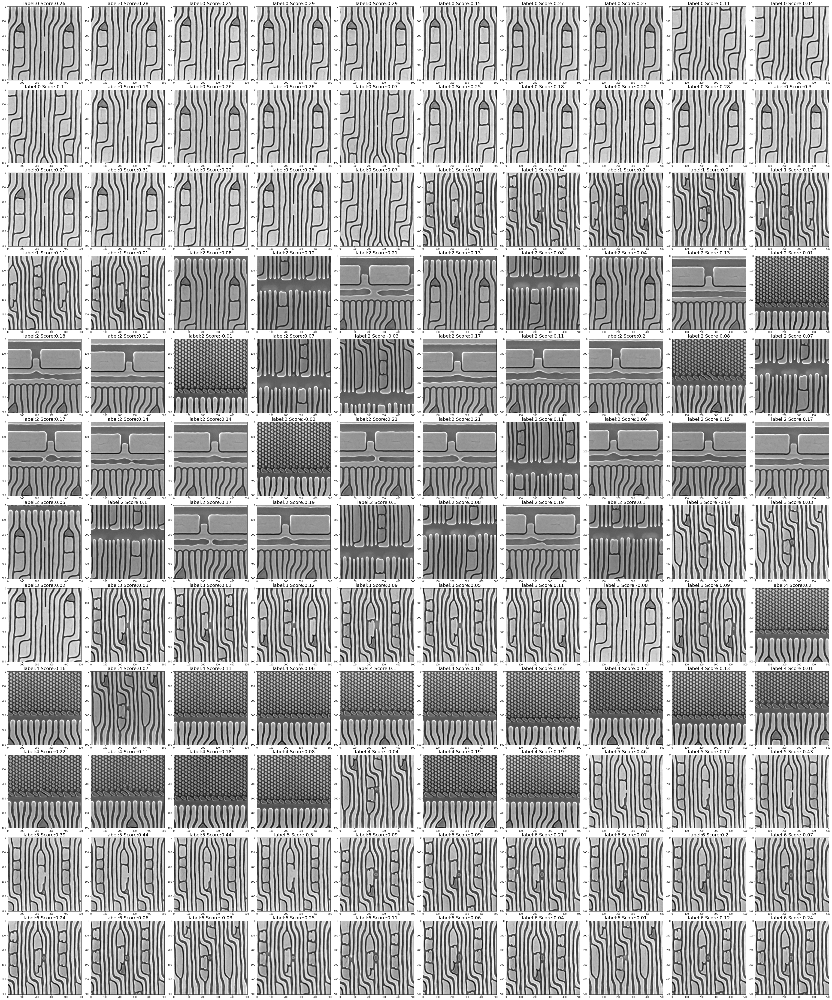

In [75]:
ncols = 10
print(len(Data))
nrows = int(len(Data)/ncols)
figsize = [50, 60]  
fig,ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axi = ax.flat
#print(len(axi))
for i,x in enumerate(Data):
  input_img = df['Image'][i]
  axi[i].set_title("label:"+str(df['Label'][i])+" "+"Score:"+str(round(df['Score'][i],2)),fontsize =20)
  axi[i].imshow(input_img,cmap='gray',vmin=0,vmax=1)
fig.tight_layout(pad=0.3)
plt.show

In [66]:
k_range = 20
Score = np.empty(20)
for k in range(k_range):
  kmeans = KMeans(n_clusters=k+2,random_state=0).fit(Attributes_scaled)
  Clustering_labels_k = kmeans.labels_
  Score[k] = silhouette_score(Attributes_scaled,Clustering_labels_k,metric='euclidean')
print(Score)
Max_score_k = np.argmax(Score) + 2
print(Max_score_k)


[0.19714636 0.15260107 0.12874442 0.1225712  0.14641138 0.1438714
 0.14297896 0.13437679 0.14207211 0.13904503 0.14222933 0.14375862
 0.12365736 0.12802339 0.12193921 0.11439747 0.11620383 0.12348842
 0.10561991 0.11733057]
2
